In [1]:
import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

from datetime import timedelta, datetime
#import holidays

import matplotlib
import pickle
import seaborn as sns

import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objs as go

matplotlib.pyplot.style.use('ggplot')
%matplotlib inline

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.float_format', lambda x: '%.6f' % x)
pd.set_option('display.width', 500)

In [2]:
uf_test = pd.read_csv('../../data/user_features_test.csv')
users_test = pd.read_csv('../../data/users_test.csv')

In [3]:
df_test = pd.merge(users_test, uf_test, on='ID')

In [4]:
df_test.shape

(585730, 86)

In [5]:
df_test['first_prediction'].min()

9.999999406318238e-05

In [6]:
df_test['first_prediction'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 585730 entries, 0 to 585729
Series name: first_prediction
Non-Null Count   Dtype  
--------------   -----  
568452 non-null  float64
dtypes: float64(1)
memory usage: 4.5 MB


In [7]:
df_test['log_first_prediction'] = np.log(df_test['first_prediction'])

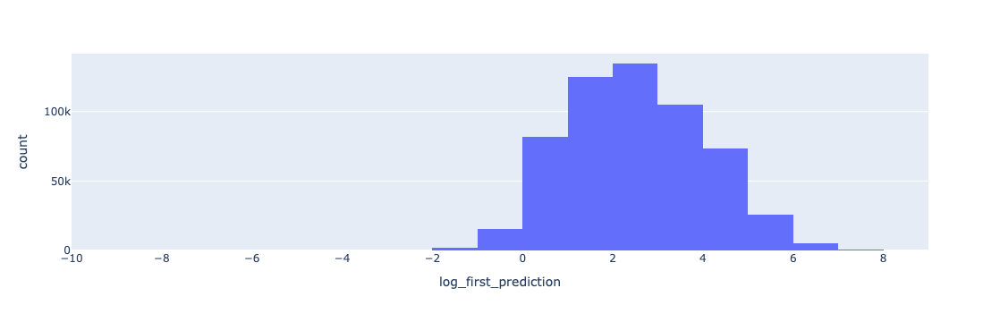

In [8]:
fig = px.histogram(df_test, x="log_first_prediction", nbins=20)
fig.show()

In [9]:
df_test['log_first_prediction'].describe()

count   568452.000000
mean         2.497501
std          1.513215
min         -9.210340
25%          1.362159
50%          2.425789
75%          3.572686
max          8.493836
Name: log_first_prediction, dtype: float64

In [10]:
df_test['economic_class'] = np.where((0.0 > round(df_test['log_first_prediction'], 1)), 'poor', 'Nan')
df_test['economic_class'] = np.where((0.0 <= round(df_test['log_first_prediction'], 1)) & 
                                      ((round(df_test['log_first_prediction'], 1) < 2.5)), 'lower_middle_class', df_test['economic_class'])
df_test['economic_class'] = np.where((2.5 <= round(df_test['log_first_prediction'], 1)) & 
                                      ((round(df_test['log_first_prediction'], 1) <= 5.0)), 'upper_middle_class', df_test['economic_class'])
df_test['economic_class'] = np.where((5.0 < round(df_test['log_first_prediction'], 1)), 'wealthy', df_test['economic_class'])

In [11]:
df_test['economic_class'].value_counts()

economic_class
lower_middle_class    271112
upper_middle_class    257181
wealthy                23963
Nan                    17278
poor                   16196
Name: count, dtype: int64

In [12]:
LvlDuration_cols = ['Level_1_Duration', 'Level_2_Duration', 'Level_3_Duration', 'Level_4_Duration', 'Level_5_Duration', 
                   'Level_6_Duration', 'Level_7_Duration', 'Level_8_Duration', 'Level_9_Duration', 'Level_10_Duration']

df_test[LvlDuration_cols] = df_test[LvlDuration_cols].fillna(0.0)

df_test['Retention_count_D0_3'] = (df_test['RetentionD0'].astype(int) + df_test['RetentionD1'].astype(int) + 
                                        df_test['RetentionD2'].astype(int) + df_test['RetentionD3'].astype(int))
df_test['Retention_count_D4_7'] = (df_test['RetentionD4'].astype(int) + df_test['RetentionD5'].astype(int) + 
                                        df_test['RetentionD6'].astype(int) + df_test['RetentionD7'].astype(int))

df_test['Retention_count_D8_11'] = (df_test['RetentionD8'].astype(int) + df_test['RetentionD9'].astype(int) + 
                                        df_test['RetentionD10'].astype(int) + df_test['RetentionD11'].astype(int))

df_test['Retention_count_D12_15'] = (df_test['RetentionD12'].astype(int) + df_test['RetentionD13'].astype(int) + 
                                        df_test['RetentionD14'].astype(int) + df_test['RetentionD15'].astype(int))
df_test['Avg_Lvl_Count_D0_3'] = (df_test['LevelAdvancedCountD0'] + df_test['LevelAdvancedCountD1'] +
                                 df_test['LevelAdvancedCountD2'] + df_test['LevelAdvancedCountD3']) / 4.0
df_test['Avg_Lvl_Count_D4_7'] = (df_test['LevelAdvancedCountD4'] + df_test['LevelAdvancedCountD5'] +
                                 df_test['LevelAdvancedCountD6'] + df_test['LevelAdvancedCountD7']) / 4.0

df_test['Avg_Lvl_Count_D8_11'] = (df_test['LevelAdvancedCountD8'] + df_test['LevelAdvancedCountD9'] +
                                 df_test['LevelAdvancedCountD10'] + df_test['LevelAdvancedCountD11']) / 4.0

df_test['Avg_Lvl_Count_D12_15'] = (df_test['LevelAdvancedCountD12'] + df_test['LevelAdvancedCountD13'] +
                                 df_test['LevelAdvancedCountD14'] + df_test['LevelAdvancedCountD15']) / 4.0

df_test['Avg_Duration_Lvl0_3'] = (df_test['Level_1_Duration'] + df_test['Level_2_Duration'] +
                                 df_test['Level_3_Duration']) / 3.0

df_test['Avg_Duration_Lvl4_7'] = (df_test['Level_4_Duration'] + df_test['Level_5_Duration'] +
                                 df_test['Level_6_Duration'] + df_test['Level_7_Duration']) / 4.0

df_test['Avg_Duration_Lvl8_10'] = (df_test['Level_8_Duration'] + df_test['Level_9_Duration'] +
                                 df_test['Level_10_Duration']) / 3.0
df_test['Total_AdRevenueD0_3'] = (df_test['AdRevenueD0'] + df_test['AdRevenueD1'] + 
                                        df_test['AdRevenueD2'] + df_test['AdRevenueD3'])

df_test['Total_AdRevenueD4_7'] = (df_test['AdRevenueD4'] + df_test['AdRevenueD5'] + 
                                        df_test['AdRevenueD6'] + df_test['AdRevenueD7'])

df_test['Total_AdRevenueD8_11'] = (df_test['AdRevenueD8'] + df_test['AdRevenueD9'] + 
                                        df_test['AdRevenueD10'] + df_test['AdRevenueD11'])

df_test['Total_AdRevenueD12_15'] = (df_test['AdRevenueD12'] + df_test['AdRevenueD13'] + 
                                        df_test['AdRevenueD14'] + df_test['AdRevenueD15'])
df_test['Total_IAPRevenueD0_3'] = (df_test['IAPRevenueD0'] + df_test['IAPRevenueD1'] + 
                                        df_test['IAPRevenueD2'] + df_test['IAPRevenueD3'])

df_test['Total_IAPRevenueD4_7'] = (df_test['IAPRevenueD4'] + df_test['IAPRevenueD5'] + 
                                        df_test['IAPRevenueD6'] + df_test['IAPRevenueD7'])

df_test['Total_IAPRevenueD8_11'] = (df_test['IAPRevenueD8'] + df_test['IAPRevenueD9'] + 
                                        df_test['IAPRevenueD10'] + df_test['IAPRevenueD11'])

df_test['Total_IAPRevenueD12_15'] = (df_test['IAPRevenueD12'] + df_test['IAPRevenueD13'] + 
                                        df_test['IAPRevenueD14'] + df_test['IAPRevenueD15'])
df_test['Total_AdRevenue'] = df_test['Total_AdRevenueD0_3'] + df_test['Total_AdRevenueD4_7'] + df_test['Total_AdRevenueD8_11'] + df_test['Total_AdRevenueD12_15']

df_test['Total_IAPRevenue'] = df_test['Total_IAPRevenueD0_3'] + df_test['Total_IAPRevenueD4_7'] + df_test['Total_IAPRevenueD8_11'] + df_test['Total_IAPRevenueD12_15']

df_test['first_open_date'] = pd.to_datetime(df_test['first_open_date'], format='%Y-%m-%d')

df_test['open_year'] = df_test['first_open_date'].apply(lambda x:x.year)
df_test['open_month'] = df_test['first_open_date'].apply(lambda x:x.month)

In [15]:
df_test_grande = df_test.copy()

In [16]:
df_test = df_test[['ID', 'open_year', 'open_month', 'first_prediction', 'log_first_prediction', 'economic_class',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15', 'Avg_Duration_Lvl0_3',
         'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 'Total_AdRevenueD0_3', 'Total_AdRevenueD4_7', 'Total_AdRevenueD8_11', 
         'Total_AdRevenueD12_15', 'Total_IAPRevenueD0_3', 'Total_IAPRevenueD4_7', 'Total_IAPRevenueD8_11', 'Total_IAPRevenueD12_15', 
                       'Total_AdRevenue', 'Total_IAPRevenue']]

In [17]:
df_test_grande.head()

,ID,first_open_date,first_open_timestamp,local_first_open_timestamp,country,platform,device_category,device_brand,device_model,has_ios_att_permission,ad_network,first_prediction,RetentionD0,RetentionD1,RetentionD2,RetentionD3,RetentionD4,RetentionD5,RetentionD6,RetentionD7,RetentionD8,RetentionD9,RetentionD10,RetentionD11,RetentionD12,RetentionD13,RetentionD14,RetentionD15,LevelAdvancedCountD0,LevelAdvancedCountD1,LevelAdvancedCountD2,LevelAdvancedCountD3,LevelAdvancedCountD4,LevelAdvancedCountD5,LevelAdvancedCountD6,LevelAdvancedCountD7,LevelAdvancedCountD8,LevelAdvancedCountD9,LevelAdvancedCountD10,LevelAdvancedCountD11,LevelAdvancedCountD12,LevelAdvancedCountD13,LevelAdvancedCountD14,LevelAdvancedCountD15,Level_1_Duration,Level_2_Duration,Level_3_Duration,Level_4_Duration,Level_5_Duration,Level_6_Duration,Level_7_Duration,Level_8_Duration,Level_9_Duration,Level_10_Duration,AdRevenueD0,AdRevenueD1,AdRevenueD2,AdRevenueD3,AdRevenueD4,AdRevenueD5,AdRevenueD6,AdRevenueD7,AdRevenueD8,AdRevenueD9,AdRevenueD10,AdRevenueD11,AdRevenueD12,AdRevenueD13,AdRevenueD14,AdRevenueD15,IAPRevenueD0,IAPRevenueD1,IAPRevenueD2,IAPRevenueD3,IAPRevenueD4,IAPRevenueD5,IAPRevenueD6,IAPRevenueD7,IAPRevenueD8,IAPRevenueD9,IAPRevenueD10,IAPRevenueD11,IAPRevenueD12,IAPRevenueD13,IAPRevenueD14,IAPRevenueD15,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,open_year,open_month
0,878594,2024-05-12,1715478163668000,1715467363668000,Argentina,Android,mobile,Motorola,Moto G32,False,applovin_int,1.444805,True,True,True,True,True,False,False,False,False,False,False,False,False,False,False,False,10,5,1,0,0,0,0,0,0,0,0,0,0,0,0,0,16.000000,147.000000,81.000000,68.000000,265.000000,184.000000,142.000000,133.000000,59.000000,157.000000,0.001595,0.009382,0.001740,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.367975,lower_middle_class,4,1,0,0,4.000000,0.000000,0.000000,0.000000,81.333333,164.750000,116.333333,0.012716,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012716,0.000000,2024,5
1,878595,2024-01-26,1706254855890000,1706233255890000,Mexico,Android,mobile,OnePlus,Nord N20 SE,False,applovin_int,9.147972,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,17.000000,209.000000,84.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.213532,lower_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,103.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2024,1
2,878596,2024-02-13,1707778260263000,1707781860263000,France,Android,mobile,Motorola,moto g13,False,applovin_int,40.731158,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,19.000000,73.000000,130.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00

In [18]:
df_test.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
0,878594,2024,5,1.444805,0.367975,lower_middle_class,4,1,0,0,4.000000,0.000000,0.000000,0.000000,81.333333,164.750000,116.333333,0.012716,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012716,0.000000
1,878595,2024,1,9.147972,2.213532,lower_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,103.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,878596,2024,2,40.731158,3.706993,upper_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,878597,2024,2,4.967959,1.603009,lower_middle_class,2,2,2,0,0.750000,4.250000,0.500000,0.000000,508.000000,695.750000,394.333333,0.000000,0.156159,0.112909,0.000000,0.000000,0.000000,0.000000,0.000000,0.269068,0.000000
4,878598,2024,5,2.445842,0.894389,lower_middle_class,3,2,0,0,11.000000,8.750000,0.000000,0.000000,56.333333,85.250000,55.000000,0.004202,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004202,0.000000


In [19]:
df_test.to_csv('../../data/df_test_preprocessed.csv', index=False)

In [20]:
df_poor = df_test[df_test['economic_class'] == 'poor']
df_lower_mid = df_test[df_test['economic_class'] == 'lower_middle_class']
df_upper_mid = df_test[df_test['economic_class'] == 'upper_middle_class']
df_wealthy = df_test[df_test['economic_class'] == 'wealthy']
df_nan = df_test[df_test['economic_class'] == 'Nan']

In [21]:
df_test.shape

(585730, 27)

In [22]:
df_poor.shape

(16196, 27)

In [23]:
df_nan.shape

(17278, 27)

In [24]:
df_lower_mid.shape

(271112, 27)

In [25]:
df_upper_mid.shape

(257181, 27)

In [26]:
df_wealthy.shape

(23963, 27)

**df_poor**

In [27]:
df_poor.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
53,878647,2024,2,0.600000,-0.510826,poor,4,1,4,2,3.000000,1.500000,5.500000,1.250000,211.000000,298.750000,19.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0.000000,0.000000,0.000000,0.000295,0.000000
62,878656,2024,2,0.557516,-0.584264,poor,3,0,0,0,6.500000,0.000000,0.000000,0.000000,385.000000,437.000000,163.666667,0.011745,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.011745,0.000000
98,878692,2024,1,0.722123,-0.325560,poor,1,0,0,0,1.250000,0.000000,0.000000,0.000000,88.333333,71.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
104,878698,2024,1,0.811788,-0.208516,poor,1,0,0,0,1.500000,0.000000,0.000000,0.000000,70.333333,73.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
123,878717,2024,3,0.557896,-0.583583,poor,3,2,0,0,3.250000,0.250000,0.000000,0.000000,142.666667,400.000000,188.333333,0.005142,0.002086,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007227,0.000000


In [29]:
X_clas = ['log_first_prediction',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
         'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
         'Total_IAPRevenue', 'Total_AdRevenue']

In [30]:
scaler = MinMaxScaler()
X_cl = pd.DataFrame(scaler.fit_transform(df_poor[X_clas]), columns=df_poor[X_clas].columns)

In [31]:
with open('../../models/poor_classifier.pkl', 'rb') as file:
    poor_classifier = pickle.load(file)

In [32]:
poor_target_classes = poor_classifier.predict(X_cl)

In [35]:
df_poor.loc[:, 'target_class'] = poor_target_classes

In [38]:
df_poor.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class
53,878647,2024,2,0.600000,-0.510826,poor,4,1,4,2,3.000000,1.500000,5.500000,1.250000,211.000000,298.750000,19.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0
62,878656,2024,2,0.557516,-0.584264,poor,3,0,0,0,6.500000,0.000000,0.000000,0.000000,385.000000,437.000000,163.666667,0.011745,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.011745,0.000000,1
98,878692,2024,1,0.722123,-0.325560,poor,1,0,0,0,1.250000,0.000000,0.000000,0.000000,88.333333,71.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1
104,878698,2024,1,0.811788,-0.208516,poor,1,0,0,0,1.500000,0.000000,0.000000,0.000000,70.333333,73.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1
123,878717,2024,3,0.557896,-0.583583,poor,3,2,0,0,3.250000,0.250000,0.000000,0.000000,142.666667,400.000000,188.333333,0.005142,0.002086,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007227,0.000000,1


In [39]:
df_poor_zero = df_poor[df_poor['target_class'] == 1]

df_poor_zero.shape

(10782, 28)

In [40]:
df_poor_reg = df_poor[df_poor['target_class'] == 0]

df_poor_reg.shape

(5414, 28)

In [42]:
df_poor_zero.loc[:, 'log_TARGET'] = -30.0
df_poor_zero.loc[:, 'TARGET'] = 0.0 

In [47]:
X_regs = ['log_first_prediction',
          'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
          'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
          'Avg_Duration_Lvl0_3',	'Avg_Duration_Lvl4_7',	'Avg_Duration_Lvl8_10',
          'Total_IAPRevenue', 'Total_AdRevenue']

In [48]:
scaler = MinMaxScaler()
X_re = pd.DataFrame(scaler.fit_transform(df_poor_reg[X_regs]), columns=df_poor_reg[X_regs].columns)

In [49]:
with open('../../models/poor_regressor.pkl', 'rb') as file:
    poor_regressor = pickle.load(file)

In [50]:
poor_reg_log_TARGET = poor_regressor.predict(X_re)

In [53]:
df_poor_reg.loc[:, 'log_TARGET'] = poor_reg_log_TARGET

In [57]:
df_poor_reg.loc[:, 'TARGET'] = np.power(np.e, df_poor_reg['log_TARGET']) - 1.0e-22

In [84]:
df_poor_reg.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
53,878647,2024,2,0.600000,-0.510826,poor,4,1,4,2,3.000000,1.500000,5.500000,1.250000,211.000000,298.750000,19.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0,-5.777720,0.003096
305,878899,2024,5,0.726017,-0.320182,poor,4,4,3,3,12.500000,12.250000,3.000000,0.500000,75.333333,160.750000,207.000000,0.003318,0.012541,0.000008,0.000008,0.000000,0.000000,0.000000,0.000000,0.015875,0.000000,0,-6.037345,0.002388
506,879100,2024,5,0.306829,-1.181465,poor,4,4,3,3,33.500000,23.500000,24.000000,15.500000,35.000000,162.000000,88.666667,0.047152,0.022128,0.027046,0.017795,0.000000,0.000000,0.000000,0.000000,0.114120,0.000000,0,-4.733807,0.008793
576,879170,2024,2,0.600000,-0.510826,poor,4,3,0,3,32.500000,8.500000,0.000000,4.000000,15.666667,33.000000,33.666667,0.003176,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.003176,0.000000,0,-6.635850,0.001312
608,879202,2024,5,0.620059,-0.477940,poor,3,4,3,3,5.500000,24.000000,7.250000,5.000000,57.000000,140.750000,124.333333,0.005973,0.030118,0.004294,0.001913,0.000000,0.000000,0.000000,0.000000,0.042298,0.000000,0,-5.122987,0.005958


In [85]:
df_poor_zero.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
62,878656,2024,2,0.557516,-0.584264,poor,3,0,0,0,6.500000,0.000000,0.000000,0.000000,385.000000,437.000000,163.666667,0.011745,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.011745,0.000000,1,-30.000000,0.000000
98,878692,2024,1,0.722123,-0.325560,poor,1,0,0,0,1.250000,0.000000,0.000000,0.000000,88.333333,71.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
104,878698,2024,1,0.811788,-0.208516,poor,1,0,0,0,1.500000,0.000000,0.000000,0.000000,70.333333,73.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
123,878717,2024,3,0.557896,-0.583583,poor,3,2,0,0,3.250000,0.250000,0.000000,0.000000,142.666667,400.000000,188.333333,0.005142,0.002086,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007227,0.000000,1,-30.000000,0.000000
133,878727,2024,5,0.752024,-0.284987,poor,1,0,0,0,0.250000,0.000000,0.000000,0.000000,6.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000


In [58]:
df_poor_reg['TARGET'].describe()

count   5414.000000
mean       0.010902
std        0.029816
min        0.000233
25%        0.002274
50%        0.004248
75%        0.009897
max        0.953510
Name: TARGET, dtype: float64

In [59]:
df_poor_reg['log_TARGET'].describe()

count   5414.000000
mean      -5.302101
std        1.099835
min       -8.365470
25%       -6.086052
50%       -5.461369
75%       -4.615562
max       -0.047605
Name: log_TARGET, dtype: float64

In [60]:
df_poor_zero.shape

(10782, 30)

In [61]:
df_poor_reg.shape

(5414, 30)

In [62]:
df_poor = pd.concat([df_poor_zero, df_poor_reg], ignore_index=True)

In [63]:
df_poor = df_poor.sort_values(by='ID')

In [64]:
df_poor.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
10782,878647,2024,2,0.600000,-0.510826,poor,4,1,4,2,3.000000,1.500000,5.500000,1.250000,211.000000,298.750000,19.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0.000000,0.000000,0.000000,0.000295,0.000000,0,-5.777720,0.003096
0,878656,2024,2,0.557516,-0.584264,poor,3,0,0,0,6.500000,0.000000,0.000000,0.000000,385.000000,437.000000,163.666667,0.011745,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.011745,0.000000,1,-30.000000,0.000000
1,878692,2024,1,0.722123,-0.325560,poor,1,0,0,0,1.250000,0.000000,0.000000,0.000000,88.333333,71.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
2,878698,2024,1,0.811788,-0.208516,poor,1,0,0,0,1.500000,0.000000,0.000000,0.000000,70.333333,73.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
3,878717,2024,3,0.557896,-0.583583,poor,3,2,0,0,3.250000,0.250000,0.000000,0.000000,142.666667,400.000000,188.333333,0.005142,0.002086,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007227,0.000000,1,-30.000000,0.000000


**df_lower_mid**

In [66]:
df_lower_mid.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
0,878594,2024,5,1.444805,0.367975,lower_middle_class,4,1,0,0,4.000000,0.000000,0.000000,0.000000,81.333333,164.750000,116.333333,0.012716,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012716,0.000000
1,878595,2024,1,9.147972,2.213532,lower_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,103.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,878597,2024,2,4.967959,1.603009,lower_middle_class,2,2,2,0,0.750000,4.250000,0.500000,0.000000,508.000000,695.750000,394.333333,0.000000,0.156159,0.112909,0.000000,0.000000,0.000000,0.000000,0.000000,0.269068,0.000000
4,878598,2024,5,2.445842,0.894389,lower_middle_class,3,2,0,0,11.000000,8.750000,0.000000,0.000000,56.333333,85.250000,55.000000,0.004202,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004202,0.000000
8,878602,2024,4,2.728044,1.003585,lower_middle_class,4,1,1,2,4.000000,1.750000,2.750000,4.500000,54.333333,218.500000,177.666667,0.006324,0.000000,0.002612,0.004748,0.000000,0.000000,0.000000,0.000000,0.013685,0.000000


In [ ]:
X_clas = ['log_first_prediction',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
         'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
         'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_cl = pd.DataFrame(scaler.fit_transform(df_lower_mid[X_clas]), columns=df_lower_mid[X_clas].columns)

with open('../../models/lower_mid_classifier.pkl', 'rb') as file:
    lower_mid_classifier = pickle.load(file)

lower_mid_target_classes = lower_mid_classifier.predict(X_cl)

df_lower_mid.loc[:, 'target_class'] = lower_mid_target_classes

df_lower_mid_zero = df_lower_mid[df_lower_mid['target_class'] == 1]

df_lower_mid_reg = df_lower_mid[df_lower_mid['target_class'] == 0]

df_lower_mid_zero.loc[:, 'log_TARGET'] = -30.0
df_lower_mid_zero.loc[:, 'TARGET'] = 0.0 

In [ ]:
X_regs = ['log_first_prediction',
          'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
          'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
          'Avg_Duration_Lvl0_3',	'Avg_Duration_Lvl4_7',	'Avg_Duration_Lvl8_10',
          'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_re = pd.DataFrame(scaler.fit_transform(df_lower_mid_reg[X_regs]), columns=df_lower_mid_reg[X_regs].columns)

with open('../../models/lower_mid_regressor.pkl', 'rb') as file:
    lower_mid_regressor = pickle.load(file)

lower_mid_reg_log_TARGET = lower_mid_regressor.predict(X_re)

df_lower_mid_reg.loc[:, 'log_TARGET'] = lower_mid_reg_log_TARGET

df_lower_mid_reg.loc[:, 'TARGET'] = np.power(np.e, df_lower_mid_reg['log_TARGET']) - 1.0e-22

In [69]:
df_lower_mid = pd.concat([df_lower_mid_zero, df_lower_mid_reg], ignore_index=True)
df_lower_mid = df_lower_mid.sort_values(by='ID')

In [70]:
df_lower_mid.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
0,878594,2024,5,1.444805,0.367975,lower_middle_class,4,1,0,0,4.000000,0.000000,0.000000,0.000000,81.333333,164.750000,116.333333,0.012716,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012716,0.000000,1,-30.000000,0.000000
1,878595,2024,1,9.147972,2.213532,lower_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,103.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
2,878597,2024,2,4.967959,1.603009,lower_middle_class,2,2,2,0,0.750000,4.250000,0.500000,0.000000,508.000000,695.750000,394.333333,0.000000,0.156159,0.112909,0.000000,0.000000,0.000000,0.000000,0.000000,0.269068,0.000000,1,-30.000000,0.000000
3,878598,2024,5,2.445842,0.894389,lower_middle_class,3,2,0,0,11.000000,8.750000,0.000000,0.000000,56.333333,85.250000,55.000000,0.004202,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004202,0.000000,1,-30.000000,0.000000
193545,878602,2024,4,2.728044,1.003585,lower_middle_class,4,1,1,2,4.000000,1.750000,2.750000,4.500000,54.333333,218.500000,177.666667,0.006324,0.000000,0.002612,0.004748,0.000000,0.000000,0.000000,0.000000,0.013685,0.000000,0,-4.851755,0.007815


**df_upper_mid**

In [72]:
df_upper_mid.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
2,878596,2024,2,40.731158,3.706993,upper_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,878600,2024,3,41.247584,3.719593,upper_middle_class,3,0,1,0,1.500000,0.000000,0.000000,0.000000,428.333333,221.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
11,878605,2024,1,25.109375,3.223241,upper_middle_class,2,0,0,0,1.750000,0.000000,0.000000,0.000000,33.333333,62.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
13,878607,2024,3,23.539227,3.158668,upper_middle_class,2,0,0,0,9.750000,0.000000,0.000000,0.000000,56.666667,280.500000,169.333333,0.114382,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.114382,0.000000
15,878609,2024,3,150.000006,5.010635,upper_middle_class,4,4,4,4,31.750000,10.750000,14.250000,12.250000,52.333333,152.750000,128.333333,4.979673,0.808242,1.987633,1.059619,0.000000,0.000000,0.000000,0.000000,8.835167,0.000000


In [ ]:
X_clas = ['log_first_prediction',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
         'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
         'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_cl = pd.DataFrame(scaler.fit_transform(df_upper_mid[X_clas]), columns=df_upper_mid[X_clas].columns)

with open('../../models/upper_mid_classifier.pkl', 'rb') as file:
    upper_mid_classifier = pickle.load(file)

upper_mid_target_classes = upper_mid_classifier.predict(X_cl)

df_upper_mid.loc[:, 'target_class'] = upper_mid_target_classes

df_upper_mid_zero = df_upper_mid[df_upper_mid['target_class'] == 1]

df_upper_mid_reg = df_upper_mid[df_upper_mid['target_class'] == 0]

df_upper_mid_zero.loc[:, 'log_TARGET'] = -30.0
df_upper_mid_zero.loc[:, 'TARGET'] = 0.0 

In [ ]:
X_regs = ['log_first_prediction',
          'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
          'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
          'Avg_Duration_Lvl0_3',	'Avg_Duration_Lvl4_7',	'Avg_Duration_Lvl8_10',
          'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_re = pd.DataFrame(scaler.fit_transform(df_upper_mid_reg[X_regs]), columns=df_upper_mid_reg[X_regs].columns)

with open('../../models/upper_mid_regressor.pkl', 'rb') as file:
    upper_mid_regressor = pickle.load(file)

upper_mid_reg_log_TARGET = upper_mid_regressor.predict(X_re)

df_upper_mid_reg.loc[:, 'log_TARGET'] = upper_mid_reg_log_TARGET

df_upper_mid_reg.loc[:, 'TARGET'] = np.power(np.e, df_upper_mid_reg['log_TARGET']) - 1.0e-22

In [75]:
df_upper_mid = pd.concat([df_upper_mid_zero, df_upper_mid_reg], ignore_index=True)
df_upper_mid = df_upper_mid.sort_values(by='ID')

In [76]:
df_upper_mid.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
0,878596,2024,2,40.731158,3.706993,upper_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
1,878600,2024,3,41.247584,3.719593,upper_middle_class,3,0,1,0,1.500000,0.000000,0.000000,0.000000,428.333333,221.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
2,878605,2024,1,25.109375,3.223241,upper_middle_class,2,0,0,0,1.750000,0.000000,0.000000,0.000000,33.333333,62.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
3,878607,2024,3,23.539227,3.158668,upper_middle_class,2,0,0,0,9.750000,0.000000,0.000000,0.000000,56.666667,280.500000,169.333333,0.114382,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.114382,0.000000,1,-30.000000,0.000000
187847,878609,2024,3,150.000006,5.010635,upper_middle_class,4,4,4,4,31.750000,10.750000,14.250000,12.250000,52.333333,152.750000,128.333333,4.979673,0.808242,1.987633,1.059619,0.000000,0.000000,0.000000,0.000000,8.835167,0.000000,0,-0.097521,0.907083


**df_wealthy**

In [78]:
df_wealthy.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
5,878599,2024,3,163.192168,5.094928,wealthy,1,0,0,0,2.250000,0.000000,0.000000,0.000000,11.333333,60.750000,13.000000,0.106975,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.106975,0.000000
17,878611,2024,4,301.023155,5.707187,wealthy,2,0,0,0,4.250000,0.000000,0.000000,0.000000,18.666667,24.250000,37.333333,1.081970,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.081970,0.000000
50,878644,2024,4,196.189761,5.279082,wealthy,1,0,0,0,0.500000,0.000000,0.000000,0.000000,11.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
72,878666,2024,2,204.171225,5.318959,wealthy,1,0,0,0,2.250000,0.000000,0.000000,0.000000,31.666667,92.500000,35.666667,0.351412,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.351412,0.000000
99,878693,2024,1,165.000007,5.105946,wealthy,3,0,0,0,3.000000,0.000000,0.000000,0.000000,29.000000,40.000000,54.666667,0.016535,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.016535,0.000000


In [ ]:
X_clas = ['log_first_prediction',
         'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
         'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
         'Avg_Duration_Lvl0_3', 'Avg_Duration_Lvl4_7', 'Avg_Duration_Lvl8_10', 
         'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_cl = pd.DataFrame(scaler.fit_transform(df_wealthy[X_clas]), columns=df_wealthy[X_clas].columns)

with open('../../models/wealthy_classifier.pkl', 'rb') as file:
    wealthy_classifier = pickle.load(file)

wealthy_target_classes = wealthy_classifier.predict(X_cl)

df_wealthy.loc[:, 'target_class'] = wealthy_target_classes

df_wealthy_zero = df_wealthy[df_wealthy['target_class'] == 1]

df_wealthy_reg = df_wealthy[df_wealthy['target_class'] == 0]

df_wealthy_zero.loc[:, 'log_TARGET'] = -30.0
df_wealthy_zero.loc[:, 'TARGET'] = 0.0 

In [ ]:
X_regs = ['log_first_prediction',
          'Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
          'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
          'Avg_Duration_Lvl0_3',	'Avg_Duration_Lvl4_7',	'Avg_Duration_Lvl8_10',
          'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_re = pd.DataFrame(scaler.fit_transform(df_wealthy_reg[X_regs]), columns=df_wealthy_reg[X_regs].columns)

with open('../../models/wealthy_regressor.pkl', 'rb') as file:
    wealthy_regressor = pickle.load(file)

wealthy_reg_log_TARGET = wealthy_regressor.predict(X_re)

df_wealthy_reg.loc[:, 'log_TARGET'] = wealthy_reg_log_TARGET

df_wealthy_reg.loc[:, 'TARGET'] = np.power(np.e, df_wealthy_reg['log_TARGET']) - 1.0e-22

In [81]:
df_wealthy = pd.concat([df_wealthy_zero, df_wealthy_reg], ignore_index=True)
df_wealthy = df_wealthy.sort_values(by='ID')

In [82]:
df_wealthy.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
0,878599,2024,3,163.192168,5.094928,wealthy,1,0,0,0,2.250000,0.000000,0.000000,0.000000,11.333333,60.750000,13.000000,0.106975,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.106975,0.000000,1,-30.000000,0.000000
1,878611,2024,4,301.023155,5.707187,wealthy,2,0,0,0,4.250000,0.000000,0.000000,0.000000,18.666667,24.250000,37.333333,1.081970,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.081970,0.000000,1,-30.000000,0.000000
2,878644,2024,4,196.189761,5.279082,wealthy,1,0,0,0,0.500000,0.000000,0.000000,0.000000,11.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
3,878666,2024,2,204.171225,5.318959,wealthy,1,0,0,0,2.250000,0.000000,0.000000,0.000000,31.666667,92.500000,35.666667,0.351412,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.351412,0.000000,1,-30.000000,0.000000
4,878693,2024,1,165.000007,5.105946,wealthy,3,0,0,0,3.000000,0.000000,0.000000,0.000000,29.000000,40.000000,54.666667,0.016535,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.016535,0.000000,1,-30.000000,0.000000


**df_nan**

In [86]:
df_nan.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue
7,878601,2024,4,NaN,NaN,Nan,1,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
65,878659,2024,5,NaN,NaN,Nan,1,0,0,0,0.750000,0.000000,0.000000,0.000000,76.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
86,878680,2024,4,NaN,NaN,Nan,1,0,0,0,3.000000,0.000000,0.000000,0.000000,64.000000,115.000000,131.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
116,878710,2024,1,NaN,NaN,Nan,1,1,0,0,1.000000,0.000000,0.000000,0.000000,36.333333,6.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
146,878740,2024,4,NaN,NaN,Nan,2,0,0,0,10.000000,0.000000,0.000000,0.000000,83.333333,154.500000,139.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [ ]:
X_clas = ['Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
          'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
          'Avg_Duration_Lvl0_3',	'Avg_Duration_Lvl4_7',	'Avg_Duration_Lvl8_10',
          'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_cl = pd.DataFrame(scaler.fit_transform(df_nan[X_clas]), columns=df_nan[X_clas].columns)

with open('../../models/nan_classifier.pkl', 'rb') as file:
    nan_classifier = pickle.load(file)

nan_target_classes = nan_classifier.predict(X_cl)

df_nan.loc[:, 'target_class'] = nan_target_classes

df_nan_zero = df_nan[df_nan['target_class'] == 1]

df_nan_reg = df_nan[df_nan['target_class'] == 0]

df_nan_zero.loc[:, 'log_TARGET'] = -30.0
df_nan_zero.loc[:, 'TARGET'] = 0.0 

In [ ]:
X_regs = ['Retention_count_D0_3', 'Retention_count_D4_7', 'Retention_count_D8_11', 'Retention_count_D12_15',
          'Avg_Lvl_Count_D0_3', 'Avg_Lvl_Count_D4_7', 'Avg_Lvl_Count_D8_11', 'Avg_Lvl_Count_D12_15',
          'Avg_Duration_Lvl0_3',	'Avg_Duration_Lvl4_7',	'Avg_Duration_Lvl8_10',
          'Total_IAPRevenue', 'Total_AdRevenue']

scaler = MinMaxScaler()
X_re = pd.DataFrame(scaler.fit_transform(df_nan_reg[X_regs]), columns=df_nan_reg[X_regs].columns)

with open('../../models/nan_regressor.pkl', 'rb') as file:
    nan_regressor = pickle.load(file)

nan_reg_log_TARGET = nan_regressor.predict(X_re)

df_nan_reg.loc[:, 'log_TARGET'] = nan_reg_log_TARGET

df_nan_reg.loc[:, 'TARGET'] = np.power(np.e, df_nan_reg['log_TARGET']) - 1.0e-22

In [89]:
df_nan = pd.concat([df_nan_zero, df_nan_reg], ignore_index=True)
df_nan = df_nan.sort_values(by='ID')

In [91]:
df_nan.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
0,878601,2024,4,NaN,NaN,Nan,1,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
1,878659,2024,5,NaN,NaN,Nan,1,0,0,0,0.750000,0.000000,0.000000,0.000000,76.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
2,878680,2024,4,NaN,NaN,Nan,1,0,0,0,3.000000,0.000000,0.000000,0.000000,64.000000,115.000000,131.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
3,878710,2024,1,NaN,NaN,Nan,1,1,0,0,1.000000,0.000000,0.000000,0.000000,36.333333,6.250000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
4,878740,2024,4,NaN,NaN,Nan,2,0,0,0,10.000000,0.000000,0.000000,0.000000,83.333333,154.500000,139.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000


**df_sub**

In [92]:
df_sub = pd.concat([df_poor, df_nan], ignore_index=True)

In [93]:
df_sub = pd.concat([df_sub, df_lower_mid], ignore_index=True)

In [94]:
df_sub = pd.concat([df_sub, df_upper_mid], ignore_index=True)

In [95]:
df_sub = pd.concat([df_sub, df_wealthy], ignore_index=True)

In [96]:
df_sub = df_sub.sort_values(by='ID')

In [97]:
df_sub.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
33474,878594,2024,5,1.444805,0.367975,lower_middle_class,4,1,0,0,4.000000,0.000000,0.000000,0.000000,81.333333,164.750000,116.333333,0.012716,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012716,0.000000,1,-30.000000,0.000000
33475,878595,2024,1,9.147972,2.213532,lower_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,103.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
304586,878596,2024,2,40.731158,3.706993,upper_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
33476,878597,2024,2,4.967959,1.603009,lower_middle_class,2,2,2,0,0.750000,4.250000,0.500000,0.000000,508.000000,695.750000,394.333333,0.000000,0.156159,0.112909,0.000000,0.000000,0.000000,0.000000,0.000000,0.269068,0.000000,1,-30.000000,0.000000
33477,878598,2024,5,2.445842,0.894389,lower_middle_class,3,2,0,0,11.000000,8.750000,0.000000,0.000000,56.333333,85.250000,55.000000,0.004202,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004202,0.000000,1,-30.000000,0.000000


In [98]:
df_sub['TARGET'] = df_sub['TARGET'] + (df_sub['Total_AdRevenue'] + df_sub['Total_IAPRevenue'])

In [99]:
df_sub.head()

,ID,open_year,open_month,first_prediction,log_first_prediction,economic_class,Retention_count_D0_3,Retention_count_D4_7,Retention_count_D8_11,Retention_count_D12_15,Avg_Lvl_Count_D0_3,Avg_Lvl_Count_D4_7,Avg_Lvl_Count_D8_11,Avg_Lvl_Count_D12_15,Avg_Duration_Lvl0_3,Avg_Duration_Lvl4_7,Avg_Duration_Lvl8_10,Total_AdRevenueD0_3,Total_AdRevenueD4_7,Total_AdRevenueD8_11,Total_AdRevenueD12_15,Total_IAPRevenueD0_3,Total_IAPRevenueD4_7,Total_IAPRevenueD8_11,Total_IAPRevenueD12_15,Total_AdRevenue,Total_IAPRevenue,target_class,log_TARGET,TARGET
33474,878594,2024,5,1.444805,0.367975,lower_middle_class,4,1,0,0,4.000000,0.000000,0.000000,0.000000,81.333333,164.750000,116.333333,0.012716,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.012716,0.000000,1,-30.000000,0.012716
33475,878595,2024,1,9.147972,2.213532,lower_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,103.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
304586,878596,2024,2,40.731158,3.706993,upper_middle_class,1,0,0,0,0.750000,0.000000,0.000000,0.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1,-30.000000,0.000000
33476,878597,2024,2,4.967959,1.603009,lower_middle_class,2,2,2,0,0.750000,4.250000,0.500000,0.000000,508.000000,695.750000,394.333333,0.000000,0.156159,0.112909,0.000000,0.000000,0.000000,0.000000,0.000000,0.269068,0.000000,1,-30.000000,0.269068
33477,878598,2024,5,2.445842,0.894389,lower_middle_class,3,2,0,0,11.000000,8.750000,0.000000,0.000000,56.333333,85.250000,55.000000,0.004202,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.004202,0.000000,1,-30.000000,0.004202


In [100]:
df_sub_grande = df_sub.copy()

In [101]:
df_sub = df_sub[['ID','TARGET']]

In [102]:
df_sub.head()

,ID,TARGET
33474,878594,0.012716
33475,878595,0.000000
304586,878596,0.000000
33476,878597,0.269068
33477,878598,0.004202


In [103]:
df_sub.to_csv('../../data/submissions/df_sub.csv', index=False)

In [104]:
df_sub_grande.to_csv('../../data/test_economic_class/df_sub_grande.csv', index=False)
df_poor.to_csv('../../data/test_economic_class/df_poor.csv', index=False)
df_lower_mid.to_csv('../../data/test_economic_class/df_lower_mid.csv', index=False)
df_upper_mid.to_csv('../../data/test_economic_class/df_upper_mid.csv', index=False)
df_wealthy.to_csv('../../data/test_economic_class/df_wealthy.csv', index=False)
df_nan.to_csv('../../data/test_economic_class/df_nan.csv', index=False)